In [ ]:
!pip install pandas

# Cleaning, Normalization

In [ ]:
import pandas as pd

# Load the dataset from the uploaded file
file_path = ('diabetes_dataset.csv')
data = pd.read_csv(file_path)

# Display the first few rows of the dataset to understand its structure
data.head()

,year,gender,age,location,race:AfricanAmerican,race:Asian,race:Caucasian,race:Hispanic,race:Other,hypertension,heart_disease,smoking_history,bmi,hbA1c_level,blood_glucose_level,diabetes
0,2020,Female,32.0,Alabama,0,0,0,0,1,0,0,never,27.32,5.0,100,0
1,2015,Female,29.0,Alabama,0,1,0,0,0,0,0,never,19.95,5.0,90,0
2,2015,Male,18.0,Alabama,0,0,0,0,1,0,0,never,23.76,4.8,160,0
3,2015,Male,41.0,Alabama,0,0,1,0,0,0,0,never,27.32,4.0,159,0
4,2016,Female,52.0,Alabama,1,0,0,0,0,0,0,never,23.75,6.5,90,0


In [ ]:
data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 16 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   year                  100000 non-null  int64  
 1   gender                100000 non-null  object 
 2   age                   100000 non-null  float64
 3   location              100000 non-null  object 
 4   race:AfricanAmerican  100000 non-null  int64  
 5   race:Asian            100000 non-null  int64  
 6   race:Caucasian        100000 non-null  int64  
 7   race:Hispanic         100000 non-null  int64  
 8   race:Other            100000 non-null  int64  
 9   hypertension          100000 non-null  int64  
 10  heart_disease         100000 non-null  int64  
 11  smoking_history       100000 non-null  object 
 12  bmi                   100000 non-null  float64
 13  hbA1c_level           100000 non-null  float64
 14  blood_glucose_level   100000 non-null  int64  
 15  d

In [ ]:
# 1. Membersihkan dan Normalisasi Kolom Kategorikal
# Mengubah gender menjadi binary (0: Female, 1: Male)
data['gender'] = data['gender'].map({'Female': 0, 'Male': 1})

# Mengubah smoking_history menjadi kategori numerik
smoking_mapping = {value: idx for idx, value in enumerate(data['smoking_history'].unique())}
data['smoking_history'] = data['smoking_history'].map(smoking_mapping)


In [ ]:
# 2. Deteksi Outlier Menggunakan IQR untuk Kolom Numerik
def detect_outliers_iqr(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[column] < lower_bound) | (df[column] > upper_bound)]

# Kolom numerik untuk dianalisis outlier
numeric_columns = ['age', 'bmi', 'hbA1c_level', 'blood_glucose_level']
outliers = {col: detect_outliers_iqr(data, col) for col in numeric_columns}


In [ ]:
# 3. Menangani Outlier dengan Winsorization (Menggunakan Batas IQR)
for col in numeric_columns:
    Q1 = data[col].quantile(0.25)
    Q3 = data[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    data[col] = data[col].clip(lower=lower_bound, upper=upper_bound)

# Ringkasan setelah pembersihan
cleaned_data_info = {
    "outliers_detected": {col: outliers[col].shape[0] for col in numeric_columns},
    "head_after_cleaning": data.head()
}

cleaned_data_info

{'outliers_detected': {'age': 0,
  'bmi': 7086,
  'hbA1c_level': 1315,
  'blood_glucose_level': 2038},
 'head_after_cleaning':    year  gender   age location  race:AfricanAmerican  race:Asian  \
 0  2020     0.0  32.0  Alabama                     0           0   
 1  2015     0.0  29.0  Alabama                     0           1   
 2  2015     1.0  18.0  Alabama                     0           0   
 3  2015     1.0  41.0  Alabama                     0           0   
 4  2016     0.0  52.0  Alabama                     1           0   
 
    race:Caucasian  race:Hispanic  race:Other  hypertension  heart_disease  \
 0               0              0           1             0              0   
 1               0              0           0             0              0   
 2               0              0           1             0              0   
 3               1              0           0             0              0   
 4               0              0           0             0         

In [ ]:
import pandas as pd

# Mengatur Pandas untuk menampilkan semua baris dan kolom
pd.set_option('display.max_rows', None)  # Menampilkan semua baris
pd.set_option('display.max_columns', None)  # Menampilkan semua kolom

# Menampilkan data lengkap
print(data)


       year  gender    age              location  race:AfricanAmerican  \
0      2020     0.0  32.00               Alabama                     0   
1      2015     0.0  29.00               Alabama                     0   
2      2015     1.0  18.00               Alabama                     0   
3      2015     1.0  41.00               Alabama                     0   
4      2016     0.0  52.00               Alabama                     1   
5      2016     1.0  66.00               Alabama                     0   
6      2015     0.0  49.00               Alabama                     0   
7      2016     0.0  15.00               Alabama                     0   
8      2016     1.0  51.00               Alabama                     1   
9      2015     1.0  42.00               Alabama                     0   
10     2016     1.0  15.00               Alabama                     1   
11     2016     0.0  53.00               Alabama                     0   
12     2015     0.0   3.00            

In [ ]:
import pandas as pd

# Load the cleaned dataset
file_path = 'diabetes_dataset.csv'
data = pd.read_csv(file_path)

# Step 1: Normalize columns if not done
# Convert 'gender' to binary
data['gender'] = data['gender'].map({'Female': 0, 'Male': 1})

# Map 'smoking_history' to numerical categories
smoking_mapping = {value: idx for idx, value in enumerate(data['smoking_history'].unique())}
data['smoking_history'] = data['smoking_history'].map(smoking_mapping)

# Step 2: Handle outliers if not handled
numeric_columns = ['age', 'bmi', 'hbA1c_level', 'blood_glucose_level']
for col in numeric_columns:
    Q1 = data[col].quantile(0.25)
    Q3 = data[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    data[col] = data[col].clip(lower=lower_bound, upper=upper_bound)

# Step 3: Split data into features and target
features = data.drop(columns=['diabetes'])
target = data['diabetes']

# Display the summary of features and target
print("Features Shape:", features.shape)
print("Target Distribution:\n", target.value_counts())
print("Features Preview:\n", features.head())


Features Shape: (100000, 15)
Target Distribution:
 diabetes
0    91500
1     8500
Name: count, dtype: int64
Features Preview:
    year  gender   age location  race:AfricanAmerican  race:Asian  \
0  2020     0.0  32.0  Alabama                     0           0   
1  2015     0.0  29.0  Alabama                     0           1   
2  2015     1.0  18.0  Alabama                     0           0   
3  2015     1.0  41.0  Alabama                     0           0   
4  2016     0.0  52.0  Alabama                     1           0   

   race:Caucasian  race:Hispanic  race:Other  hypertension  heart_disease  \
0               0              0           1             0              0   
1               0              0           0             0              0   
2               0              0           1             0              0   
3               1              0           0             0              0   
4               0              0           0             0              0   

 

# Visualisasi analisis melalui Dashboard

<ipython-input-39-6594155c9dff>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=target, palette="Set2")


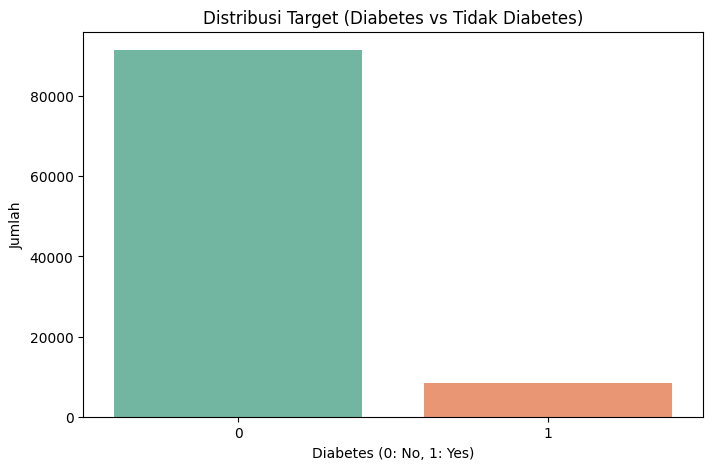

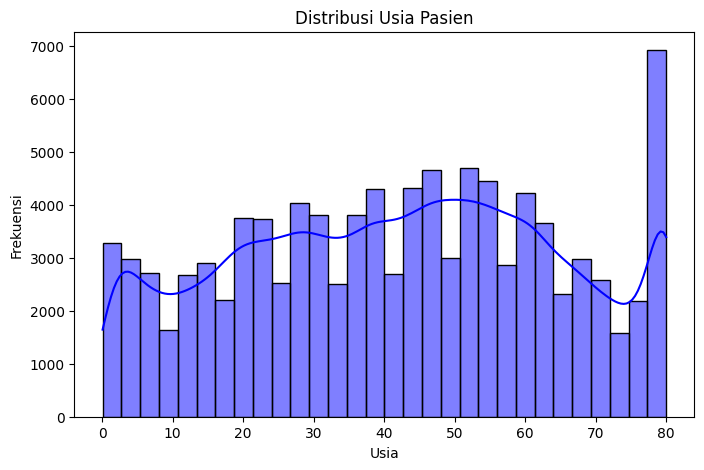

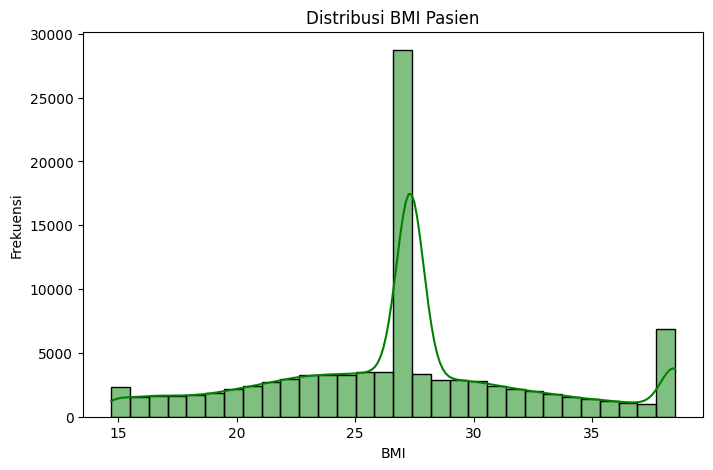

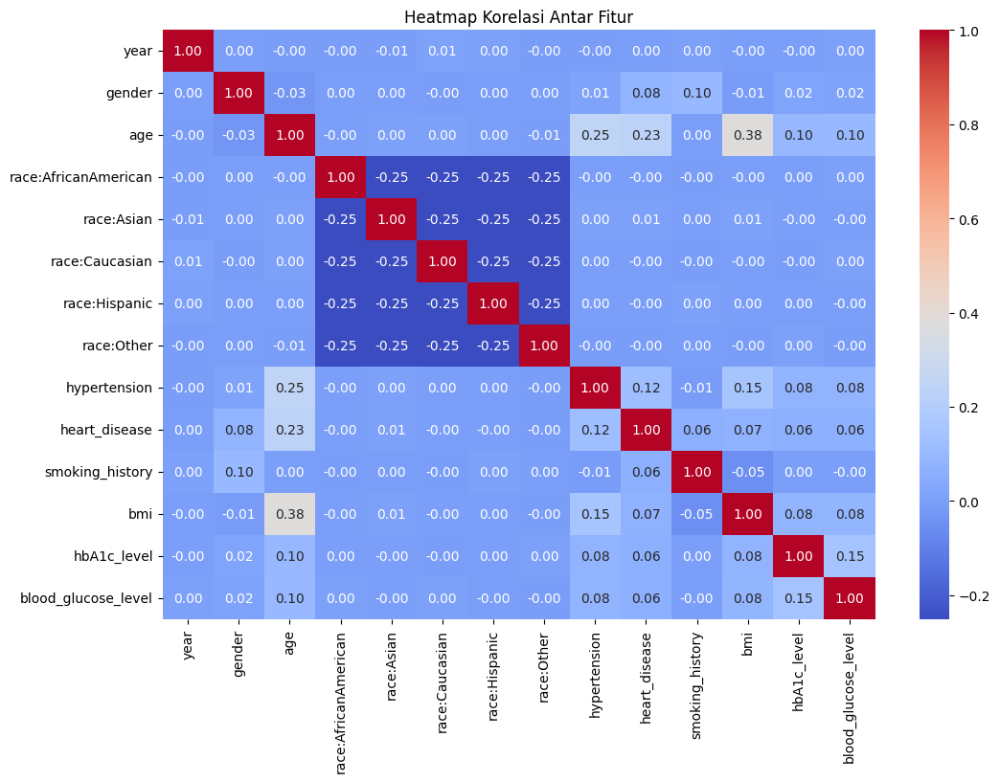

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# Create visualizations
# Target distribution
plt.figure(figsize=(8, 5))
sns.countplot(x=target, palette="Set2")
plt.title("Distribusi Target (Diabetes vs Tidak Diabetes)")
plt.xlabel("Diabetes (0: No, 1: Yes)")
plt.ylabel("Jumlah")
plt.show()

# Age distribution
plt.figure(figsize=(8, 5))
sns.histplot(data['age'], kde=True, color='blue', bins=30)
plt.title("Distribusi Usia Pasien")
plt.xlabel("Usia")
plt.ylabel("Frekuensi")
plt.show()

# BMI distribution
plt.figure(figsize=(8, 5))
sns.histplot(data['bmi'], kde=True, color='green', bins=30)
plt.title("Distribusi BMI Pasien")
plt.xlabel("BMI")
plt.ylabel("Frekuensi")
plt.show()

# Correlation heatmap (hanya gunakan fitur numerik untuk perhitungan korelasi)
numeric_features = features.select_dtypes(include=['float64', 'int64'])  # Pilih hanya numerik
plt.figure(figsize=(12, 8))
correlation_matrix = numeric_features.corr()
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Heatmap Korelasi Antar Fitur")
plt.show()

# Visualisasi hubungan dengan target (diabetes)
fig = px.box(data, x='gender', y='bmi', color='diabetes')
fig.update_layout(title="Perbandingan BMI dengan Status Diabetes berdasarkan Gender",
                  xaxis_title="Gender",
                  yaxis_title="BMI")
fig.show()

# Visualisasi hubungan smoking_history dan diabetes
fig2 = px.box(data, x='smoking_history', y='blood_glucose_level', color='diabetes')
fig2.update_layout(title="Perbandingan Blood Glucose Level berdasarkan Smoking History dan Status Diabetes",
                   xaxis_title="Smoking History",
                   yaxis_title="Blood Glucose Level")
fig2.show()


# Hyperparameter Tuning dengan CrossValidator

In [ ]:
from pyspark.sql import SparkSession

# Initialize Spark Session
spark = SparkSession.builder.appName('Diabetes Prediction with Cross-Validation').getOrCreate()

# Load data
file_path = "diabetes_dataset.csv"
data = spark.read.csv(file_path, header=True, inferSchema=True)

# Menampilkan informasi awal dataset untuk memahami struktur
data.printSchema()
data.show(5)


root
 |-- year: integer (nullable = true)
 |-- gender: string (nullable = true)
 |-- age: double (nullable = true)
 |-- location: string (nullable = true)
 |-- race:AfricanAmerican: integer (nullable = true)
 |-- race:Asian: integer (nullable = true)
 |-- race:Caucasian: integer (nullable = true)
 |-- race:Hispanic: integer (nullable = true)
 |-- race:Other: integer (nullable = true)
 |-- hypertension: integer (nullable = true)
 |-- heart_disease: integer (nullable = true)
 |-- smoking_history: string (nullable = true)
 |-- bmi: double (nullable = true)
 |-- hbA1c_level: double (nullable = true)
 |-- blood_glucose_level: integer (nullable = true)
 |-- diabetes: integer (nullable = true)

+----+------+----+--------+--------------------+----------+--------------+-------------+----------+------------+-------------+---------------+-----+-----------+-------------------+--------+
|year|gender| age|location|race:AfricanAmerican|race:Asian|race:Caucasian|race:Hispanic|race:Other|hypertension|h

In [ ]:
from pyspark.ml.feature import VectorAssembler

# Pilih fitur numerik untuk dimasukkan sebagai input dan target
numerical_features = [
    'age',
    'hypertension',
    'heart_disease',
    'bmi',
    'hbA1c_level',
    'blood_glucose_level',
    'year'
]
target_column = 'diabetes'

# Gabungkan fitur numerik dengan VectorAssembler
vec_assembler = VectorAssembler(inputCols=numerical_features, outputCol="features")
data = vec_assembler.transform(data)

# Ubah kolom target menjadi label
data = data.withColumnRenamed(target_column, "label")

# Membagi data menjadi training dan testing
train_data, test_data = data.randomSplit([0.8, 0.2], seed=123)


In [ ]:
from pyspark.ml.classification import LogisticRegression
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

# Membuat model Logistic Regression
lr = LogisticRegression(featuresCol="features", labelCol="label")

# Membuat Grid untuk Hyperparameter Tuning
paramGrid = (ParamGridBuilder()
             .addGrid(lr.regParam, [0.01, 0.1, 1.0])  # Regularization Parameter
             .addGrid(lr.elasticNetParam, [0.0, 0.5, 1.0])  # Elastic Net mixing parameter
             .build())

# CrossValidator untuk melakukan hyperparameter tuning dengan evaluasi
evaluator = MulticlassClassificationEvaluator(labelCol="label", predictionCol="prediction", metricName="accuracy")
cv = CrossValidator(estimator=lr,
                     estimatorParamMaps=paramGrid,
                     evaluator=evaluator,
                     numFolds=5)  # Gunakan 5 lipatan (folds) untuk cross-validation

# Melakukan fitting pada data training
cv_model = cv.fit(train_data)

# Menampilkan model terbaik dari hasil cross-validation
best_model = cv_model.bestModel
print("Best Model Parameters:")
print(f" - regParam: {best_model._java_obj.getRegParam()}")
print(f" - elasticNetParam: {best_model._java_obj.getElasticNetParam()}")

# Melakukan prediksi pada data testing
predictions = cv_model.transform(test_data)

# Evaluasi performa model pada data uji
accuracy = evaluator.evaluate(predictions)
print(f"Accuracy on test data after cross-validation: {accuracy:.2f}")

# Menampilkan hasil prediksi dari model pada contoh data
print("Sample Predictions:")
predictions.select("features", "label", "prediction").show(10)


Best Model Parameters:
 - regParam: 0.01
 - elasticNetParam: 1.0
Accuracy on test data after cross-validation: 0.96
Sample Predictions:
+--------------------+-----+----------+
|            features|label|prediction|
+--------------------+-----+----------+
|[0.24,0.0,0.0,12....|    0|       0.0|
|[0.32,0.0,0.0,18....|    0|       0.0|
|[0.48,0.0,0.0,18....|    0|       0.0|
|[0.48,0.0,0.0,21....|    0|       0.0|
|[0.64,0.0,0.0,23....|    0|       0.0|
|[0.8,0.0,0.0,17.2...|    0|       0.0|
|[0.88,0.0,0.0,20....|    0|       0.0|
|[1.0,0.0,0.0,16.6...|    0|       0.0|
|[1.16,0.0,0.0,18....|    0|       0.0|
|[1.16,0.0,0.0,16....|    0|       0.0|
+--------------------+-----+----------+
only showing top 10 rows



### Linear Regression

In [ ]:
from pyspark.sql import SparkSession
from pyspark.ml.regression import LinearRegression
from pyspark.ml.feature import VectorAssembler

# Initialize Spark Session
spark = SparkSession.builder.appName('Diabetes Linear Regression').getOrCreate()

# Load the dataset
data = spark.read.csv('diabetes_dataset.csv', header=True, inferSchema=True)

# Seleksi fitur numerik yang akan digunakan dan target
# Dalam hal ini, kita asumsikan 'blood_glucose_level' sebagai target dan fitur lainnya sebagai prediktor
features = ['age', 'bmi', 'hbA1c_level', 'blood_glucose_level', 'hypertension', 'heart_disease']
target = 'diabetes'  # Target variabel kita untuk model regresi

# Drop data yang memiliki nilai NaN
data = data.select(features + [target])
data = data.na.drop()

# Persiapan data untuk modeling
assembler = VectorAssembler(inputCols=features, outputCol='features')
df_transformed = assembler.transform(data)

# Membuat model Linear Regression
lr = LinearRegression(featuresCol='features', labelCol=target)
model = lr.fit(df_transformed)

# Print model coefficients dan intercept
print(f'Coefficients: {model.coefficients}')
print(f'Intercept: {model.intercept}')

# Stop Spark Session
spark.stop()

Coefficients: [0.0013991335729922553,0.004262689970672885,0.08136831201623643,0.00227558879631971,0.09642742892378654,0.12000938829065833]
Intercept: -0.8659395192382253


In [ ]:
from pyspark.sql import SparkSession
from pyspark.ml.classification import LogisticRegression
from pyspark.ml.feature import VectorAssembler

# Initialize Spark Session
spark = SparkSession.builder.appName('Diabetes Logistic Regression').getOrCreate()

# Load the dataset
data = spark.read.csv('diabetes_dataset.csv', header=True, inferSchema=True)

# Define binary classification target/label (1: Diabetes, 0: No Diabetes)
data = data.withColumn("Label", (data["diabetes"] == 1).cast("integer"))
data = data.select('age', 'bmi', 'hbA1c_level', 'blood_glucose_level', 'hypertension', 'heart_disease', 'Label').na.drop()

# Assemble features into a single vector for modeling
assembler = VectorAssembler(inputCols=['age', 'bmi', 'hbA1c_level', 'blood_glucose_level', 'hypertension', 'heart_disease'], outputCol='Features')
df_transformed = assembler.transform(data)

# Train a Logistic Regression Model
lr = LogisticRegression(featuresCol='Features', labelCol='Label')
model = lr.fit(df_transformed)

# Display coefficients and intercept from the trained model
print(f'Coefficients: {model.coefficients}')
print(f'Intercept: {model.intercept}')

# Stop Spark Session
spark.stop()

Coefficients: [0.045868743610639424,0.09068731317388795,2.34138031802582,0.03344272269110144,0.809474679349474,0.8074295067598914]
Intercept: -27.301468199856565


LOGISTIC REGRESSION


In [ ]:
from pyspark.sql import SparkSession
from pyspark.ml.clustering import KMeans
from pyspark.ml.feature import VectorAssembler

# Initialize Spark Session
spark = SparkSession.builder.appName('KMeans Clustering Diabetes').getOrCreate()

# Load the dataset
data = spark.read.csv('diabetes_dataset.csv', header=True, inferSchema=True)

# Select relevant features for clustering
data = data.select('age', 'bmi', 'hbA1c_level', 'blood_glucose_level', 'hypertension', 'heart_disease').na.drop()

# Assemble features into a single vector for KMeans
assembler = VectorAssembler(
    inputCols=['age', 'bmi', 'hbA1c_level', 'blood_glucose_level', 'hypertension', 'heart_disease'],
    outputCol='Features'
)
df_transformed = assembler.transform(data)

# Train a KMeans clustering model with 3 clusters
kmeans = KMeans(featuresCol='Features', k=3)  # Assuming 3 clusters
model = kmeans.fit(df_transformed)

# Show cluster centers
centers = model.clusterCenters()
print(f'Cluster Centers: {centers}')

# Assign cluster predictions to each data point
predictions = model.transform(df_transformed)

# Display sample predictions
predictions.select('age', 'bmi', 'hbA1c_level', 'blood_glucose_level', 'hypertension', 'heart_disease', 'prediction').show(10)

# Stop Spark Session
spark.stop()

Cluster Centers: [array([4.16792476e+01, 2.72752827e+01, 5.51254903e+00, 1.52400020e+02,
       7.39147552e-02, 3.75479374e-02]), array([4.01335446e+01, 2.68873842e+01, 5.40138928e+00, 8.87452032e+01,
       5.78098351e-02, 3.08058556e-02]), array([6.12590784e+01, 3.19946781e+01, 6.92368020e+00, 2.61434239e+02,
       2.40768996e-01, 1.52578578e-01])]
+----+-----+-----------+-------------------+------------+-------------+----------+
| age|  bmi|hbA1c_level|blood_glucose_level|hypertension|heart_disease|prediction|
+----+-----+-----------+-------------------+------------+-------------+----------+
|32.0|27.32|        5.0|                100|           0|            0|         1|
|29.0|19.95|        5.0|                 90|           0|            0|         1|
|18.0|23.76|        4.8|                160|           0|            0|         0|
|41.0|27.32|        4.0|                159|           0|            0|         0|
|52.0|23.75|        6.5|                 90|           0|        

### KMeans Clustering

In [ ]:
from pyspark.sql import SparkSession
from pyspark.ml.clustering import KMeans
from pyspark.ml.feature import VectorAssembler

# Initialize Spark Session
spark = SparkSession.builder.appName('KMeans Clustering Diabetes').getOrCreate()

# Load the dataset
data = spark.read.csv('diabetes_dataset.csv', header=True, inferSchema=True)

# Select relevant features for clustering
data = data.select('age', 'bmi', 'hbA1c_level', 'blood_glucose_level', 'hypertension', 'heart_disease').na.drop()

# Assemble features into a single vector for KMeans
assembler = VectorAssembler(
    inputCols=['age', 'bmi', 'hbA1c_level', 'blood_glucose_level', 'hypertension', 'heart_disease'],
    outputCol='Features'
)
df_transformed = assembler.transform(data)

# Train a KMeans clustering model with 3 clusters
kmeans = KMeans(featuresCol='Features', k=3)  # Assuming 3 clusters
model = kmeans.fit(df_transformed)

# Show cluster centers
centers = model.clusterCenters()
print(f'Cluster Centers: {centers}')

# Assign cluster predictions to each data point
predictions = model.transform(df_transformed)

# Display sample predictions
predictions.select('age', 'bmi', 'hbA1c_level', 'blood_glucose_level', 'hypertension', 'heart_disease', 'prediction').show(10)

# Stop Spark Session
spark.stop()

Cluster Centers: [array([4.16792476e+01, 2.72752827e+01, 5.51254903e+00, 1.52400020e+02,
       7.39147552e-02, 3.75479374e-02]), array([4.01335446e+01, 2.68873842e+01, 5.40138928e+00, 8.87452032e+01,
       5.78098351e-02, 3.08058556e-02]), array([6.12590784e+01, 3.19946781e+01, 6.92368020e+00, 2.61434239e+02,
       2.40768996e-01, 1.52578578e-01])]
+----+-----+-----------+-------------------+------------+-------------+----------+
| age|  bmi|hbA1c_level|blood_glucose_level|hypertension|heart_disease|prediction|
+----+-----+-----------+-------------------+------------+-------------+----------+
|32.0|27.32|        5.0|                100|           0|            0|         1|
|29.0|19.95|        5.0|                 90|           0|            0|         1|
|18.0|23.76|        4.8|                160|           0|            0|         0|
|41.0|27.32|        4.0|                159|           0|            0|         0|
|52.0|23.75|        6.5|                 90|           0|        